# YOLO11

В качестве бейзлайна я решил попробовать использовать модель YOLO11, потому что это очень популярная и довольно простая в использовании модель детекции. Она работает достаточно быстро даже для применения в режиме реального времени, хоть нам это и не требуется.

Импорт библиотек:

In [1]:
from ultralytics import YOLO
from ultralytics.engine.results import Results
import cv2
import numpy as np
import matplotlib.pyplot as plt

Функция для отрисовки результатов:

In [2]:
def draw_boxes(frame: np.ndarray, result: Results, color=(0, 255, 0)) -> np.ndarray:
    """
    Отрисовка прямоугольников на изображении

    :param frame: изображение
    :param result: результат работы YOLO над изображением
    :param color: цвет прямоугольников и текста
    """

    # Копирование кадра
    new_frame = frame.copy()

    # Цикл по предсказанным боксам
    for box in result.boxes:
        # Получение описания бокса
        x1, y1, x2, y2 = map(int, np.round(box.xyxy[0]))
        class_label = int(box.cls[0])
        confidence = box.conf[0]

        # Если бокс соответствует классу человека (0), то рисуем и подписываем его
        if class_label == 0:
            cv2.rectangle(new_frame, (x1, y1), (x2, y2), color, 2, cv2.LINE_AA)
            cv2.putText(new_frame, f'Person ({confidence:.2f})', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2, cv2.LINE_AA)

    return cv2.cvtColor(new_frame, cv2.COLOR_BGR2RGB)  # Перевод изображения в RGB-формат

## Визуализация вариаций YOLO


0: 384x640 8 persons, 2 umbrellas, 85.4ms
Speed: 4.5ms preprocess, 85.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


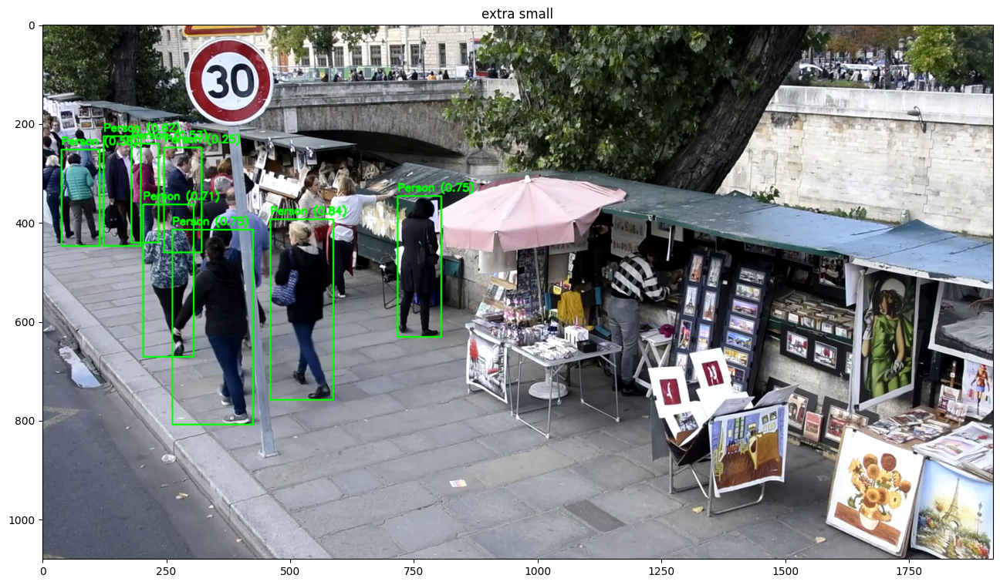


0: 384x640 13 persons, 1 stop sign, 2 umbrellas, 1 handbag, 1 chair, 1 dining table, 133.4ms
Speed: 3.1ms preprocess, 133.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


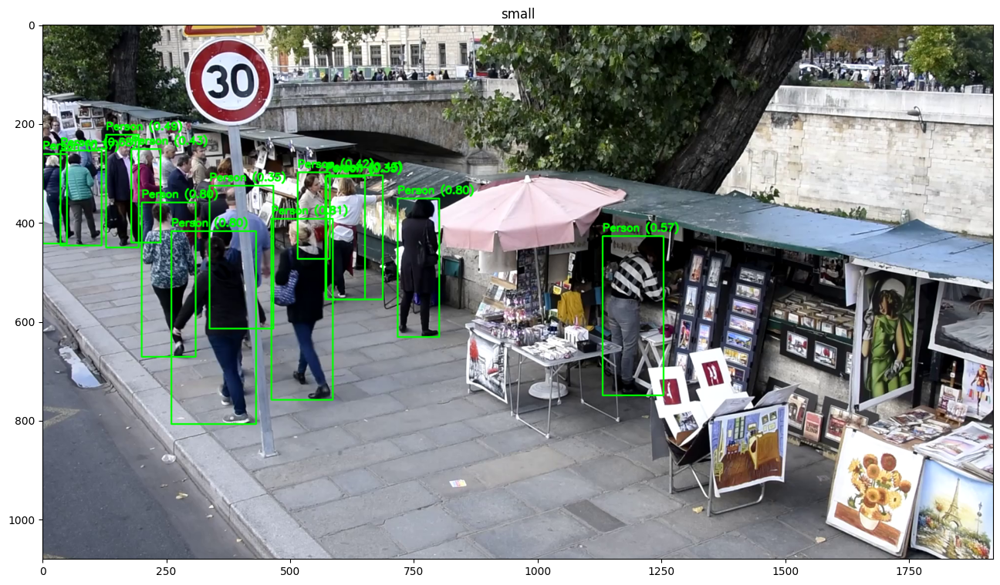


0: 384x640 14 persons, 2 umbrellas, 2 handbags, 1 dining table, 250.4ms
Speed: 2.6ms preprocess, 250.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


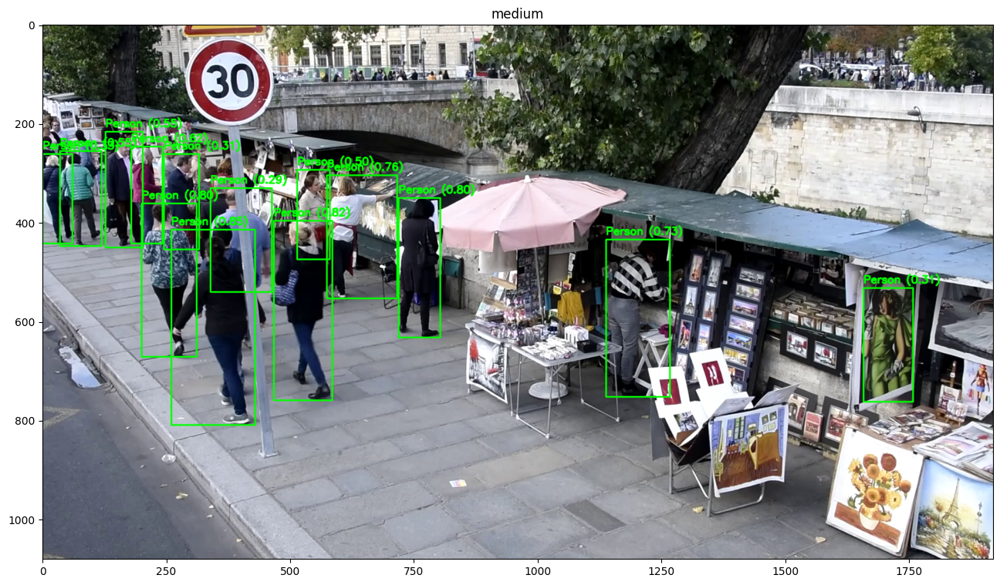


0: 384x640 13 persons, 1 umbrella, 1 handbag, 1 chair, 1 dining table, 1 book, 286.1ms
Speed: 1.9ms preprocess, 286.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


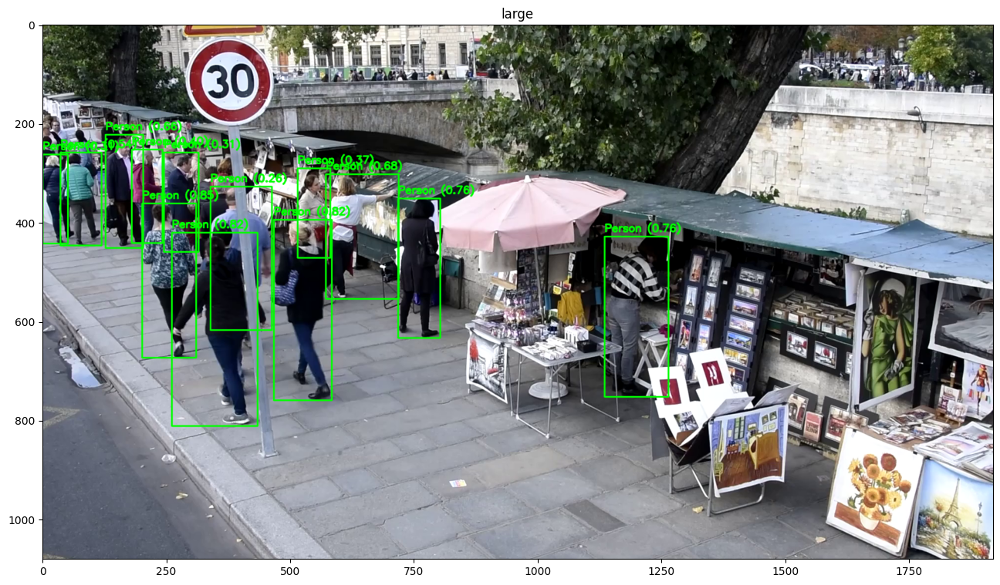


0: 384x640 11 persons, 1 stop sign, 2 umbrellas, 3 handbags, 10 donuts, 1 chair, 1 dining table, 560.0ms
Speed: 2.7ms preprocess, 560.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


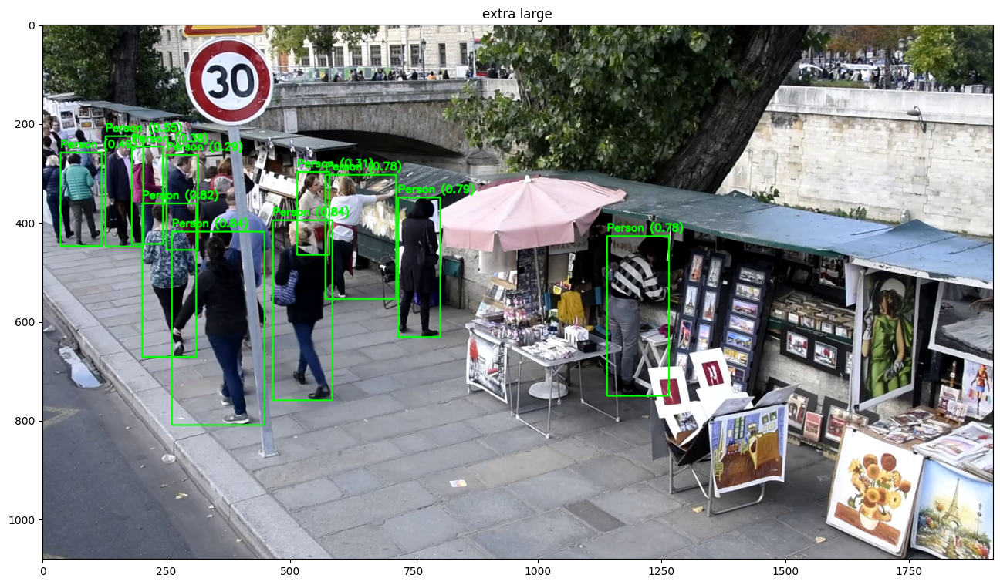

In [3]:
YOLO_MODELS = (
    ('n', 'extra small'),
    ('s', 'small'),
    ('m', 'medium'),
    ('l', 'large'),
    ('x', 'extra large')
)

# Получение первого кадра из видео
cap = cv2.VideoCapture('data/crowd.mp4')
_, frame = cap.read()
cap.release()

# Цикл по вариациям YOLO11
for code, name in YOLO_MODELS:
    # Инициализация модели
    model = YOLO(f'yolo11{code}.pt')

    # Инференс
    result = model(frame)[0]

    # Отрисовка результатов
    new_frame = draw_boxes(frame, result)

    # Отображение результатов
    plt.figure(figsize=(16, 9))
    plt.imshow(new_frame)
    plt.title(name)
    plt.show()

В принципе, даже легковесные версии YOLO11 уже довольно хорошо справляются с детектированием людей.

Но так как у нас нет особых требований на время работы, по умолчанию я буду использовать самую мощную модель.

## Визуализация порогов уверенности


0: 384x640 55 persons, 1 bicycle, 41 cars, 10 trucks, 1 stop sign, 1 bird, 6 backpacks, 6 umbrellas, 49 handbags, 34 bottles, 3 cups, 1 bowl, 25 donuts, 8 chairs, 3 dining tables, 3 tvs, 1 cell phone, 7 refrigerators, 43 books, 2 teddy bears, 539.1ms
Speed: 2.3ms preprocess, 539.1ms inference, 59.8ms postprocess per image at shape (1, 3, 384, 640)


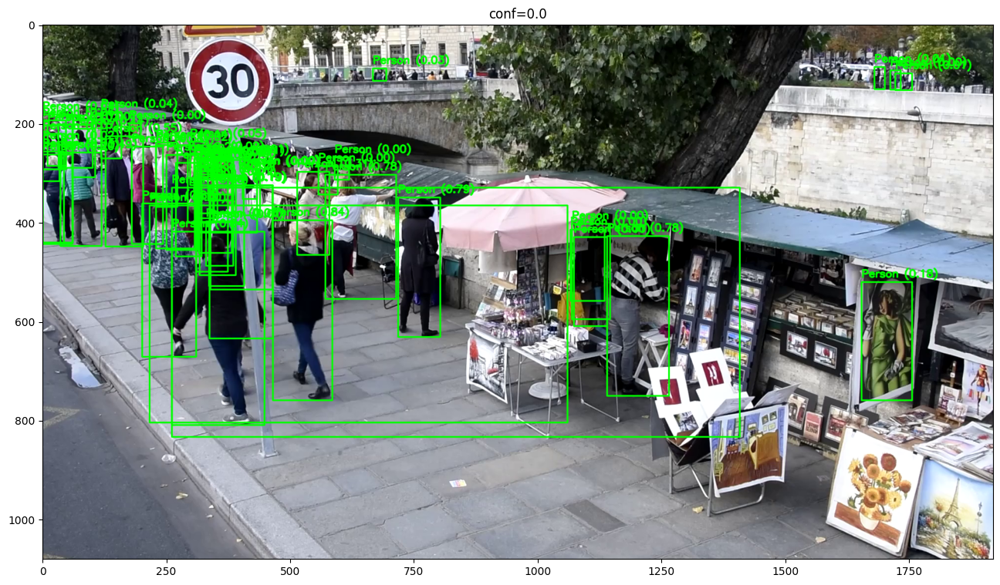


0: 384x640 18 persons, 3 cars, 1 stop sign, 2 umbrellas, 4 handbags, 12 donuts, 1 chair, 1 dining table, 590.3ms
Speed: 1.9ms preprocess, 590.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


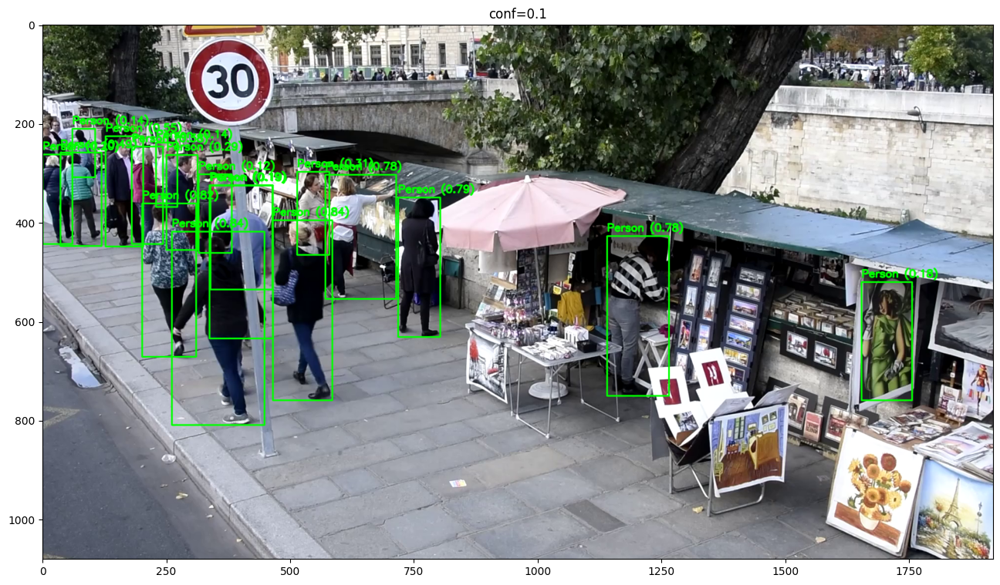


0: 384x640 12 persons, 1 stop sign, 2 umbrellas, 3 handbags, 10 donuts, 1 chair, 1 dining table, 536.9ms
Speed: 2.6ms preprocess, 536.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


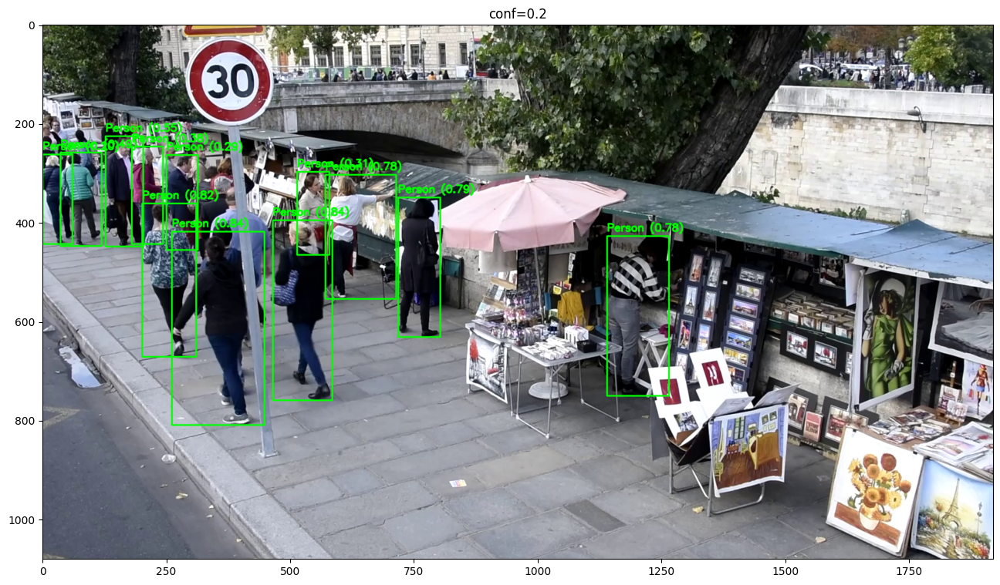


0: 384x640 10 persons, 2 umbrellas, 2 handbags, 7 donuts, 1 chair, 558.7ms
Speed: 3.0ms preprocess, 558.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


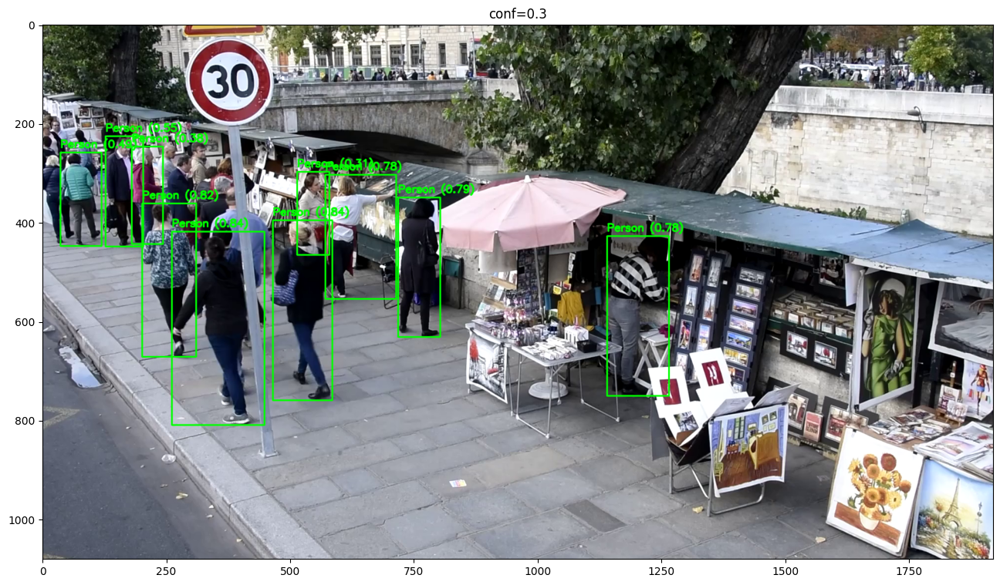


0: 384x640 8 persons, 2 umbrellas, 2 handbags, 3 donuts, 506.6ms
Speed: 1.9ms preprocess, 506.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


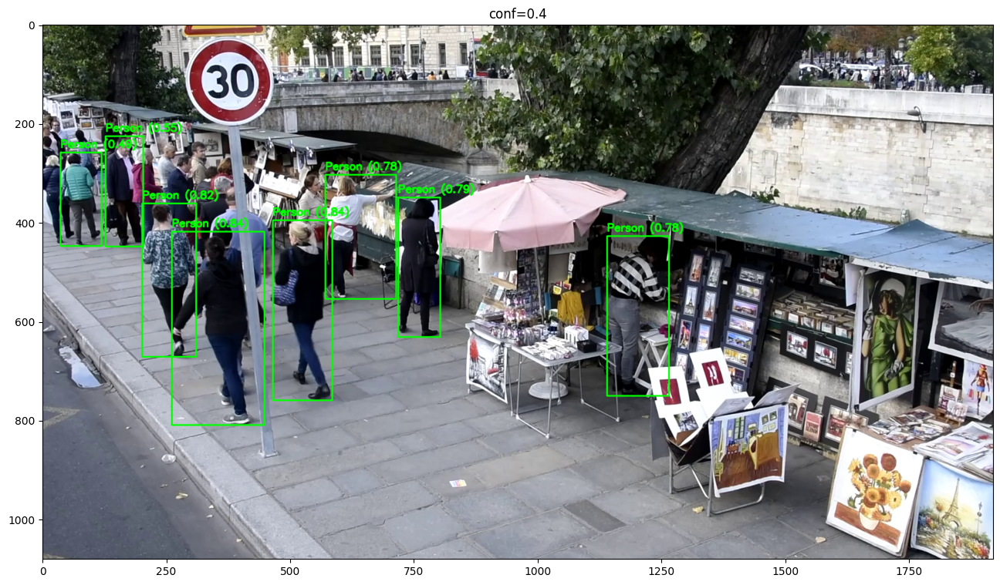


0: 384x640 7 persons, 1 umbrella, 2 handbags, 1 donut, 501.4ms
Speed: 1.8ms preprocess, 501.4ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


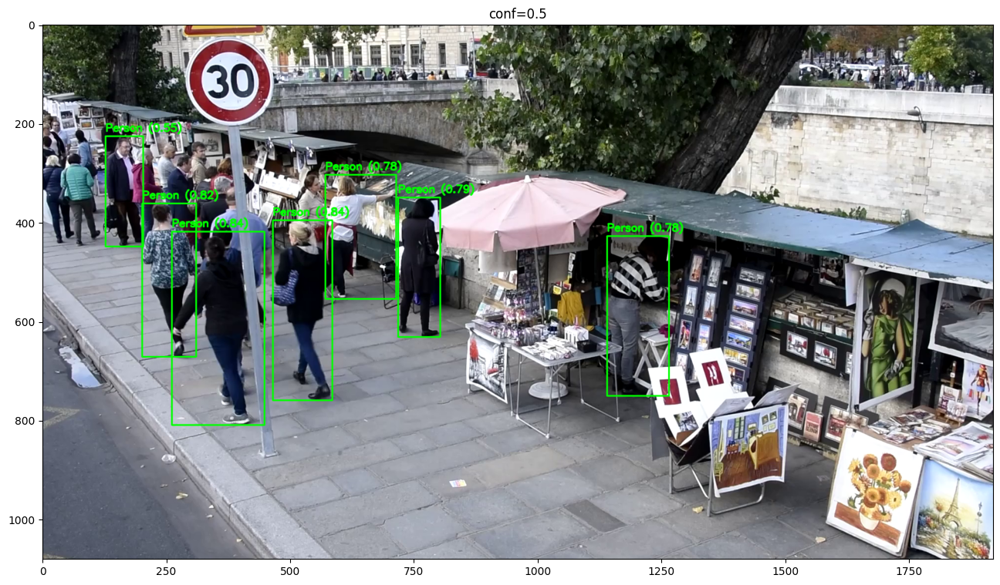


0: 384x640 6 persons, 1 handbag, 506.4ms
Speed: 1.7ms preprocess, 506.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


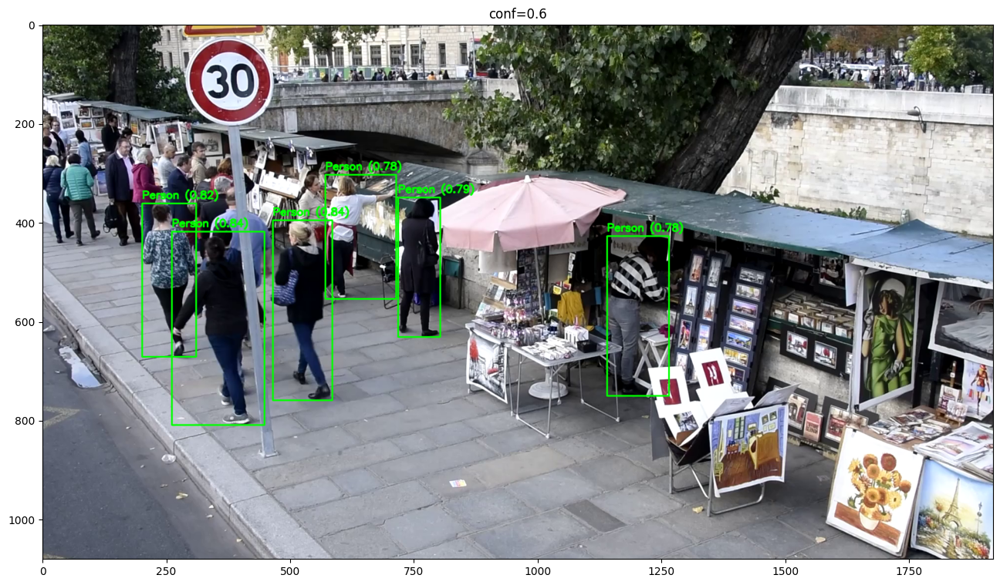


0: 384x640 6 persons, 1 handbag, 511.2ms
Speed: 1.8ms preprocess, 511.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


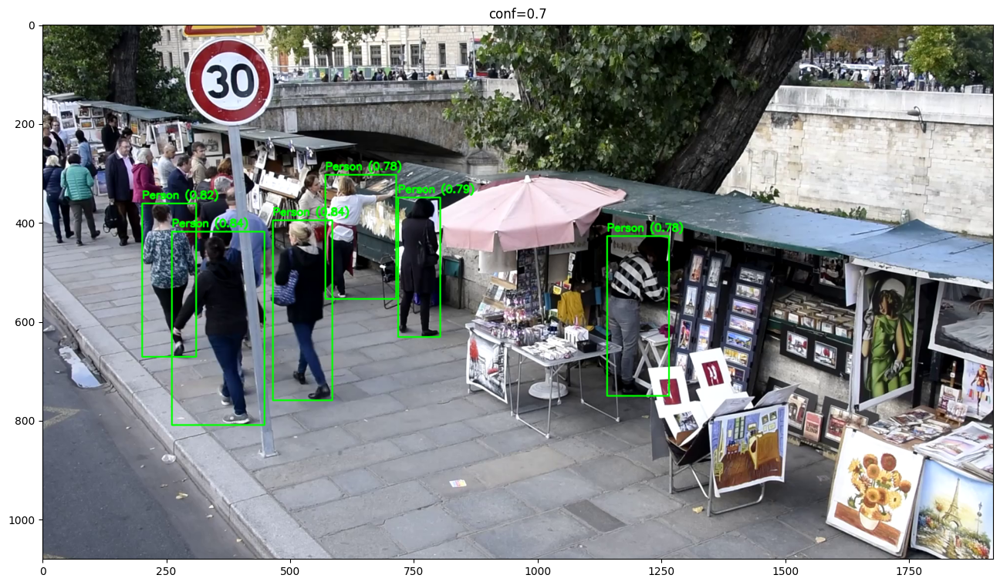


0: 384x640 3 persons, 1 handbag, 510.9ms
Speed: 2.2ms preprocess, 510.9ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


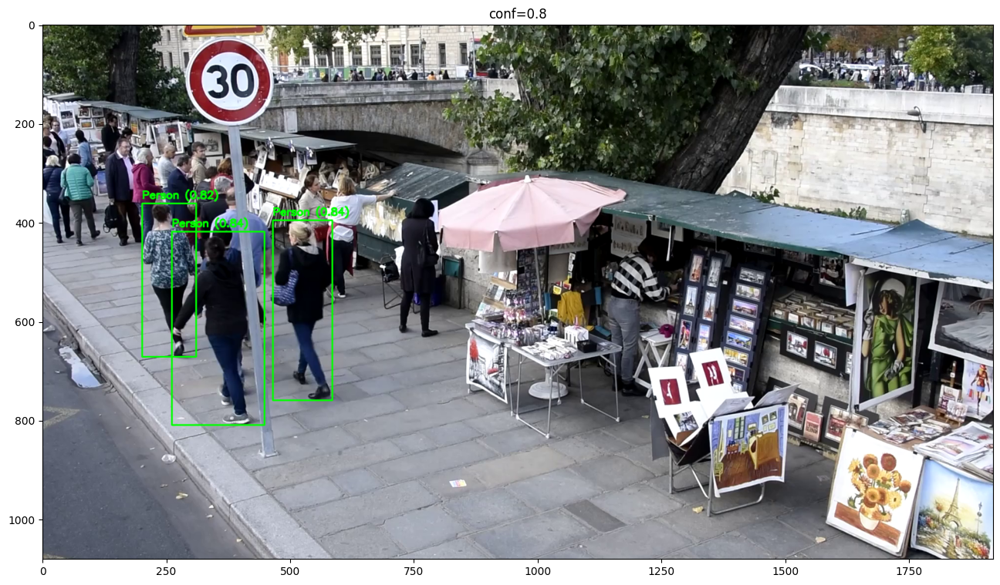


0: 384x640 (no detections), 508.7ms
Speed: 2.0ms preprocess, 508.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


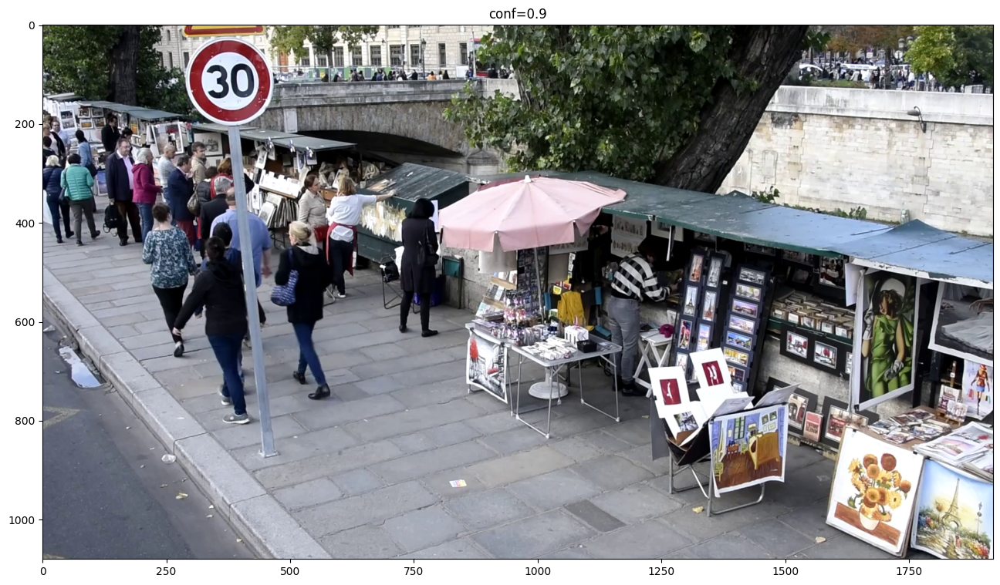

In [4]:
CONFIDENCES = np.arange(0.0, 1.0, 0.1)

# Получение первого кадра из видео
cap = cv2.VideoCapture('data/crowd.mp4')
_, frame = cap.read()
cap.release()

# Инициализация модели
model = YOLO(f'yolo11x.pt')

# Цикл по уверенностям
for confidence in CONFIDENCES:
    # Инференс
    result = model(frame, conf=confidence)[0]

    # Отрисовка результатов
    new_frame = draw_boxes(frame, result)

    # Отображение результатов
    plt.figure(figsize=(16, 9))
    plt.imshow(new_frame)
    plt.title(f'conf={confidence:.1f}')
    plt.show()

При слишком маленьких значениях `confidence` появляется много ложных срабатываний, а при слишком больших — многие люди не детектируются. Оптимальным значением для данного видео мне кажется где-то **0.1-0.3**.

В целом, я удовлетворён результатами, полученными при помощи YOLO, и пока что не вижу особого смысла пробовать использовать более мощные модели.